In [1]:
import sys

sys.path.append("../")
##CudNN Error
import tensorflow as tf
config=tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth=True
sess=tf.compat.v1.Session(config=config)
from funciones import *
K.set_session(sess)

Modulo importado con exito.... :)


In [2]:
K.clear_session() #limpiamos todos en caso de nuevo entrenamiento
img_width=224
img_height=224
INIT_LR = 1e-3
batch_size=50
epochs=200

#CARGANDO LOS DATASETS
path_root='../../datasetreal/'
path_train=path_root+'train'
path_validation=path_root+'validation'

train_gen=ImageDataGenerator(
    rescale=1./255,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True
)

validation_gen= ImageDataGenerator(rescale=1./255)

image_train=train_gen.flow_from_directory(
    path_train,
    target_size=(img_width,img_height),
    batch_size=batch_size,
    class_mode='categorical',
)

image_validation=validation_gen.flow_from_directory(
    path_validation,
    target_size=(img_width,img_height),
    batch_size=batch_size,
    class_mode='categorical'
)
nClasses=len(image_train.class_indices)
print(image_train.class_indices)

Found 2403 images belonging to 4 classes.
Found 795 images belonging to 4 classes.
{'Class A': 0, 'Class B': 1, 'Class C': 2, 'Class D': 3}


In [3]:
#Construccion del modelo
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten, Dropout

########## FROM SCRATCH  #####################
model = Sequential()

model.add(Conv2D(input_shape=(224,224,3),filters=128,kernel_size=(3,3),padding="same", activation="relu")) 
#model.add(MaxPool2D(pool_size=(2,2),strides=(3,3)))

model.add(Conv2D(input_shape=(224,224,3),filters=128,kernel_size=(3,3),padding="same", activation="relu")) 
model.add(MaxPool2D(pool_size=(4,4),strides=(3,3)))

model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu")) 
#model.add(MaxPool2D(pool_size=(4,4),strides=(3,3)))

model.add(Conv2D(filters=64,kernel_size=(3,3),padding="same", activation="relu")) 
model.add(MaxPool2D(pool_size=(4,4),strides=(3,3)))

model.add(Conv2D(filters=32, kernel_size=(3,3), padding="same", activation="relu"))
#model.add(MaxPool2D(pool_size=(4,4),strides=(3,3)))

model.add(Conv2D(filters=32, kernel_size=(3,3), padding="same", activation="relu"))
model.add(MaxPool2D(pool_size=(4,4),strides=(3,3)))


#softmax for classification 2 for 2 classes
model.add(Flatten())
model.add(Dense(units=1024,activation="relu"))
model.add(Dense(units=4, activation="softmax"))
model.summary()


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 128)     3584      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 128)     147584    
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 74, 74, 64)        73792     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 74, 74, 64)        36928     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 24, 24, 64)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 24, 24, 32)        1

In [4]:
from keras.optimizers import Adam
from keras import optimizers

model_final=model

#COMPILE
#, **kwargs
kwargs={'decay','lr'}
#opt = optimizers.Adam(lr=0.00001,beta_1=0.9, beta_2=0.899, epsilon=0.80e-07, amsgrad=False)
#opt = optimizers.Adam(lr=0.00012,beta_1=0.9, beta_2=0.899, epsilon=0.80e-07, amsgrad=False)
#sgd = optimizers.SGD(lr=0.01, decay=1e-6, momentum=0.9, nesterov=True)
#opt = optimizers.Adamax(learning_rate=0.00015, beta_1=0.9, beta_2=0.899)
opt= optimizers.Nadam(learning_rate=0.00025, beta_1=0.9, beta_2=0.899) 
#model new2 con 0.00020

model_final.compile(optimizer=opt, loss=keras.losses.categorical_crossentropy, metrics=['accuracy'])
#model_final.compile(loss = "categorical_crossentropy", optimizer = optimizers.SGD(lr=0.00025, momentum=0.9), metrics=["accuracy"])
#optimizer = optimizers.Adam(learning_rate=0.005, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False), metrics=["accuracy"])
	
model_final.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 128)     3584      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 128)     147584    
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 74, 74, 64)        73792     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 74, 74, 64)        36928     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 24, 24, 64)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 24, 24, 32)        1

In [5]:
step_train=image_train.n//image_train.batch_size
step_validation=image_validation.n//image_validation.batch_size

In [6]:

from keras.callbacks import ModelCheckpoint, EarlyStopping

#save the model with the best validation accuracy
checkpoint = ModelCheckpoint("REDBANANA_new.h5", monitor='val_accuracy', verbose=1, save_best_only=False, save_weights_only=False, mode='auto', period=5)

#stop model training if accuracy doesnt change in 40 epochs
early = EarlyStopping(monitor='val_accuracy', min_delta=0, patience=300, verbose=1, mode='auto')
print ("pasa model 1")
model_final.save_weights("REDBANANA2_new.h5")
print ("pasa model 2")
#TRAINIGN #####################################################
#pass data to the model (images) with number of epochs 100
#hist = model.fit_generator(steps_per_epoch=100,generator=image_train, validation_data= image_validation, validation_steps=10,epochs=100,callbacks=[checkpoint,early])
hist = model_final.fit_generator(steps_per_epoch=step_train,generator=image_train, validation_data= image_validation,epochs=epochs,callbacks=[checkpoint,early],validation_steps=step_validation)


pasa model 1
pasa model 2
Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/200
48/48 [==============================] - 23s 474ms/step - loss: 1.2377 - accuracy: 0.3991 - val_loss: 1.2002 - val_accuracy: 0.4040
Epoch 2/200
48/48 [==============================] - 23s 474ms/step - loss: 0.8715 - accuracy: 0.5963 - val_loss: 0.7398 - val_accuracy: 0.6480
Epoch 3/200
48/48 [==============================] - 23s 469ms/step - loss: 0.7497 - accuracy: 0.6575 - val_loss: 0.6801 - val_accuracy: 0.6893
Epoch 4/200
48/48 [==============================] - 23s 473ms/step - loss: 0.6780 - accuracy: 0.6906 - val_loss: 0.5716 - val_accuracy: 0.7520
Epoch 5/200
48/48 [==============================] - ETA: 0s - loss: 0.6367 - accuracy: 0.7297
Epoch 00005: saving model to REDBANANA_new.h5
48/48 [==============================] - 23s 477ms/step - loss: 0.6367 - accuracy: 0.7297 - val_loss: 0.5808 - val_accuracy: 0.7560
Epoch 6/200
48/48 [==============================

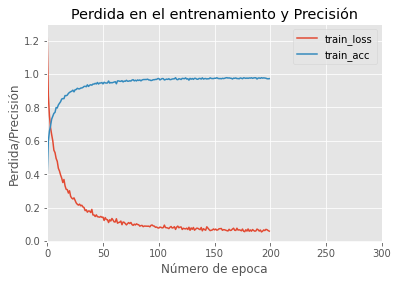

In [7]:
plt.style.use("ggplot")
plt.figure()
plt.plot(np.arange(0,epochs),hist.history['loss'],label="train_loss")
plt.plot(np.arange(0,epochs),hist.history['accuracy'],label="train_acc")
plt.title("Perdida en el entrenamiento y Precisión")
plt.xlabel("Número de epoca")
plt.ylabel("Perdida/Precisión")
plt.legend(loc="upper right")
plt.xlim(0,300)
plt.show()

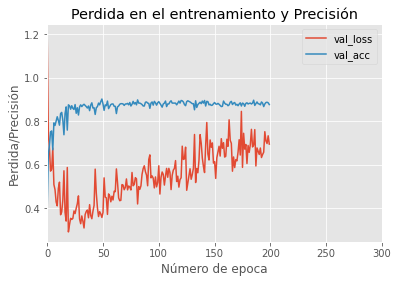

In [8]:
plt.plot(np.arange(0,epochs),hist.history['val_loss'],label="val_loss")
plt.plot(np.arange(0,epochs),hist.history['val_accuracy'],label="val_acc")
plt.title("Perdida en el entrenamiento y Precisión")
plt.xlabel("Número de epoca")
plt.ylabel("Perdida/Precisión")
plt.legend(loc="upper right")
plt.xlim(0,300)
plt.show()

In [9]:
test_datagen=ImageDataGenerator(preprocessing_function=preprocess_input)
path_test=path_root+"test_junto"
test_gen=test_datagen.flow_from_directory(
    path_test,
    target_size=(img_width,img_height),
    color_mode='rgb',
    batch_size=1,
    class_mode=None,
    shuffle=False,
    seed=42,
)

Found 800 images belonging to 1 classes.


In [10]:
steps_size_test=test_gen.n//test_gen.batch_size
pred=model.predict_generator(test_gen,steps=steps_size_test,verbose=1)
predicted_class_index=np.argmax(pred,axis=1)
print(predicted_class_index)

Instructions for updating:
Please use Model.predict, which supports generators.
800/800 [==============================] - 4s 5ms/step
[2 2 1 1 2 2 0 2 0 2 2 2 0 2 2 2 2 2 2 1 2 1 2 2 1 0 2 0 2 2 1 0 2 0 0 1 2
 1 2 2 2 2 2 1 1 1 2 2 2 2 2 1 1 0 0 2 0 2 0 2 2 0 0 0 1 0 2 0 0 2 2 2 1 2
 2 1 1 2 2 1 2 0 2 2 2 1 3 2 0 2 2 1 2 0 2 2 1 2 2 2 1 2 2 2 0 2 2 2 0 1 1
 2 2 0 1 1 2 2 0 1 2 2 1 0 2 1 1 2 0 1 1 2 2 2 2 0 2 2 2 2 1 2 2 1 2 2 0 0
 2 2 0 2 2 2 2 2 2 2 0 2 0 2 2 1 2 2 1 1 0 2 2 2 2 1 2 0 2 2 1 1 2 1 1 2 1
 2 0 3 2 1 0 2 1 0 0 2 0 0 2 1 2 2 2 0 1 2 0 0 2 2 2 2 2 2 1 2 1 2 0 2 0 2
 2 2 2 2 1 2 2 1 2 0 2 2 1 3 2 2 1 2 0 2 2 2 1 2 2 2 2 2 1 2 1 1 3 2 2 2 2
 2 2 2 1 3 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 0 2 2 1 2 2 2 2 1 0 2 2
 2 3 2 2 0 1 2 2 2 2 0 2 3 1 2 2 1 2 2 2 0 2 2 1 2 1 2 2 2 2 2 2 0 2 2 2 1
 1 2 2 2 2 1 2 2 1 2 2 1 2 2 2 2 0 0 2 1 2 2 2 2 2 2 1 1 3 2 1 1 2 2 2 2 2
 2 1 0 2 2 2 2 1 2 2 2 2 2 1 2 2 1 2 1 2 2 1 1 2 2 2 2 2 2 2 0 2 2 2 1 2 1
 2 2 2 0 0 1 2 1 2 2 2 2 1 2 2 2 2 2 2 2

In [11]:
labels=(image_train.class_indices)
labels=dict((v,k) for k,v in labels.items())
predictions=[labels[k] for k in predicted_class_index]

In [12]:
filenames=test_gen.filenames
results=pd.DataFrame({"Filenames":filenames,
                        "Prdicciones":predictions})
results                     

,Filenames,Prdicciones
0,test\7000_tipoB.png,Class C
1,test\7001_tipoB.png,Class C
2,test\7002_tipoB.png,Class B
3,test\7003_tipoB.png,Class B
4,test\7004_tipoB.png,Class C
...,...,...
795,test\981_tipoA.png,Class A
796,test\982_tipoA.png,Class C
797,test\983_tipoA.png,Class C
798,test\984_tipoB.png,Class A


In [13]:
real_class_indices=[]
for i in range(0,len(filenames)):
    your_path=filenames[i]
    path_list=your_path.split(os.sep)
    if("tipoA" in path_list[1]):
        real_class_indices.append(0)
    if("tipoB" in path_list[1]):
        real_class_indices.append(1)
    if("tipoC" in path_list[1]):
        real_class_indices.append(2)
    if("tipoD" in path_list[1]):
        real_class_indices.append(3)
print(len(real_class_indices))
print(real_class_indices)

800
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 0, 2, 2, 3, 2, 2, 2, 1, 1, 1, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2,

In [14]:
df_test_reales=pd.DataFrame({"Filenames":filenames,
                        "Predicciones_v":real_class_indices})
df_test_reales

,Filenames,Predicciones_v
0,test\7000_tipoB.png,1
1,test\7001_tipoB.png,1
2,test\7002_tipoB.png,1
3,test\7003_tipoB.png,1
4,test\7004_tipoB.png,1
...,...,...
795,test\981_tipoA.png,0
796,test\982_tipoA.png,0
797,test\983_tipoA.png,0
798,test\984_tipoB.png,1


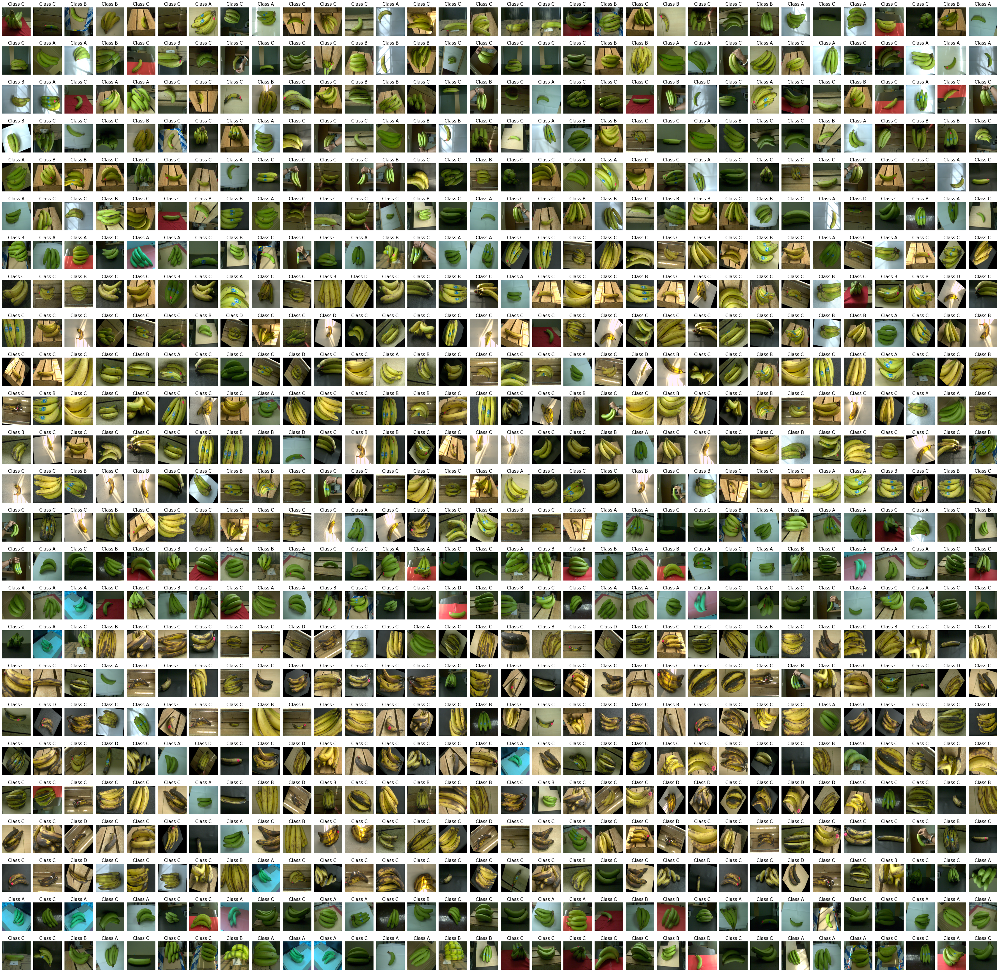

In [15]:
import matplotlib.image as mpimg

fig=plt.figure(figsize=(60,60))
fig.subplots_adjust(hspace=0.1,wspace=0.1)
rows=25
cols=len(filenames)//rows if len(filenames)%2==0 else len(filenames)//rows + 1
for i in range(0,len(filenames)):
    your_path=filenames[i]
    path_list=your_path.split(os.sep)
    img=mpimg.imread(path_test+"/test/"+path_list[1])
    ax=fig.add_subplot(rows,cols,i+1)
    ax.axis("Off")
    plt.imshow(img,interpolation=None)
    ax.set_title(predictions[i],fontsize=15)

In [16]:
from mlxtend.evaluate import confusion_matrix
from itertools import product 

matriz_conf=confusion_matrix(real_class_indices,predicted_class_index)
def plot_matriz_conf(cm,classes,normalize=False,title="Matriz de Confusión",cmap=plt.cm.Blues):
    plt.imshow(cm,interpolation="nearest",cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks=np.arange(len(classes))
    plt.xticks(tick_marks,classes,rotation=45)
    plt.yticks(tick_marks,classes)
    if normalize:
        cm=cm.astype('float')/cm.sum(axis=1)[:,np.newaxis]
        print("Matriz de confusion Normalizada")
    else:
        print("Matriz de confusion sin normalizar")
    print(cm)
    thresh=cm.max()/2.
    for i,j in product(range(cm.shape[0]),range(cm.shape[1])):
        plt.text(j,i,cm[i,j],
        horizontalalignment='center',
        color="white" if cm[i,j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel("Clase verdadera")
    plt.xlabel("Clase predecida")


Matriz de confusion sin normalizar
[[ 81  27  97   3]
 [ 37  49  99   2]
 [  8  34 146   3]
 [  0  21 172  21]]


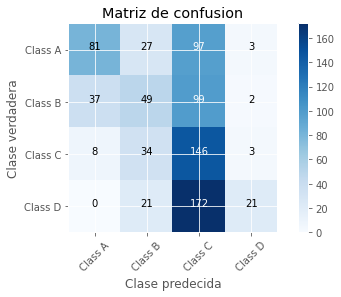

In [17]:
cm=confusion_matrix(real_class_indices,predicted_class_index)
cm_plot_labels=image_train.class_indices
plot_matriz_conf(cm,cm_plot_labels,title="Matriz de confusion")

In [18]:
#path_modelo='./modelos/inceptionV3_arch.h5'
#model.save(path_modelo)

In [19]:
#entry point, run the example
#run_example(path_test+"/test/780_tipoA.png",path_modelo)

In [20]:
import sklearn
#model = load_model(path_modelo)
##model.save_weights #para guargar los pesos

sklearn.metrics.accuracy_score(real_class_indices,predicted_class_index)

0.37125

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 128)     3584      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 128)     147584    
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 74, 74, 64)        73792     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 74, 74, 64)        36928     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 24, 24, 64)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 24, 24, 32)        1

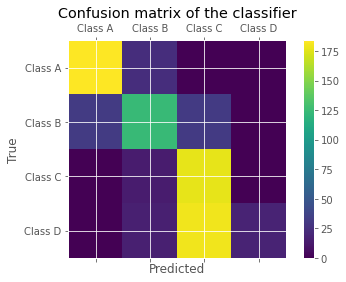

In [21]:
from keras.preprocessing.image import ImageDataGenerator
#from keras.preprocessing.image import image
from keras.models import load_model
from sklearn.metrics import plot_confusion_matrix

import cv2
import numpy as np
import matplotlib.pyplot as plt
import sklearn.metrics as metrics
import keras,os

#INDIVIDUAL PREDICTION
# img = image.load_img("sample4.png",target_size=(224,224))
# img = np.asarray(img)
# plt.imshow(img)
# img = np.expand_dims(img, axis=0)
# from keras.models import load_model
# saved_model = load_model("vgg16_4.h5")
# output = saved_model.predict(img)
# print("garbage",output[0][0])
# print("good",output[0][1])
# print("broken",output[0][2])
# print("rotten",output[0][3])

batch_size = 1
def accuracy(confusion_matrix):
    diagonal_sum = confusion_matrix.trace()
    sum_of_all_elements = confusion_matrix.sum()
    return diagonal_sum / sum_of_all_elements 

#from keras.models import load_weights
saved_model = load_model("REDBANANA_new.h5")
#saved_model = load_weights('vgg16_4.h6')
saved_model.summary()

#test_generator = ImageDataGenerator(vertical_flip=True, horizontal_flip=True, rotation_range=360)
test_generator = ImageDataGenerator()
test_data_generator = test_generator.flow_from_directory(
    directory=path_root+"test", # Put your path here
    target_size=(224,224),
    #batch_size=32,
    shuffle=False)
test_steps_per_epoch = np.math.ceil(test_data_generator.samples / test_data_generator.batch_size)

predictions = saved_model.predict_generator(test_data_generator, steps=test_steps_per_epoch)
# Get most likely class
predicted_classes = np.argmax(predictions, axis=1)

###########################################
true_classes = test_data_generator.classes
class_labels = list(test_data_generator.class_indices.keys())   

#print(class_labels) 
print("-------------------")
print(true_classes)
print("-------------------")
print(predicted_classes)
print("-------------------")
print(class_labels)



report = metrics.classification_report(true_classes, predicted_classes, target_names=class_labels)
cm = metrics.confusion_matrix(true_classes, predicted_classes,labels=[0,1,2,3])

print(cm)

print(report)    

print("Accuracy: ", accuracy(cm))


fig = plt.figure() 
ax = fig.add_subplot(111) 
cax = ax.matshow(cm) 
plt.title('Confusion matrix of the classifier') 
fig.colorbar(cax) 
ax.set_xticklabels([''] + class_labels) 
ax.set_yticklabels([''] + class_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

In [ ]:
from numba import cuda
cuda.select_device(0)
cuda.close()